# Self-Driving Car Engineer Nanodegree
## Deep Learning
## Project: Advanced Lane Finding Project

---
### Step 0: Imports

In [1]:
import numpy as np
import cv2
import math
import os
import glob
from collections import deque
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline

---
### Step 1: Camera Calibration

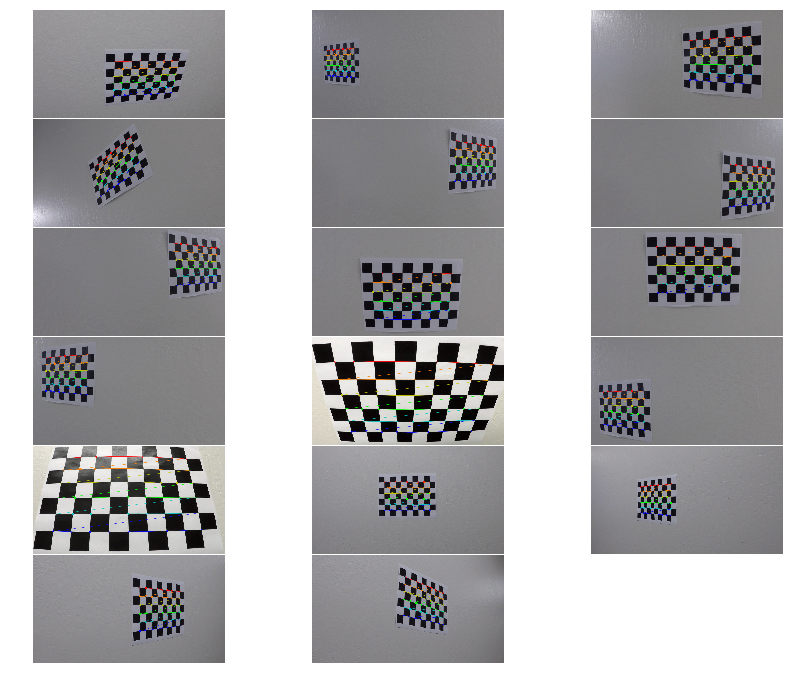

Camera calibrated using 17 images.


In [2]:
objpoints = []
imgpoints = []

# Points used for defining lane area trapezoid
src_left_top = [570, 470]
src_right_top = [720, 470]
src_right_bottom = [1050, 690]
src_left_bottom = [245, 690]

# Points used for warping
dst_left_top = [400, 0]
dst_right_top =[900, 0]
dst_right_bottom = [900, 720]
dst_left_bottom = [400, 720]
   
def calibrate_camera(calibration_images_full_path):
    '''
    Calibrates camera using the provided chessboard images
    '''
    termination_criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    calib_img_count = 0
    images = glob.glob(calibration_images_full_path)   
    objp = np.zeros((6*9,3),np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2) # x,y coords
    gray = None
    fig = plt.figure(figsize=(15, 12))
    fig.subplots_adjust(hspace = .01, wspace = 0.000000001)
    
    for fname in images:
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        calib_image_width, calib_image_height = gray.shape[::-1]
        pattern_matched,corners = cv2.findChessboardCorners(gray,(9,6),None)
        if pattern_matched == True:
            objpoints.append(objp)
            # For fine-tuning
            cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),termination_criteria)
            img = cv2.drawChessboardCorners(img,(9,6),corners,pattern_matched)
            calib_img_count +=1
            plt.subplot(6, 3, calib_img_count)
            plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
            plt.axis('off')
            corners = corners.reshape(-1, 2)
            imgpoints.append(corners)
    plt.show()       
    
    rms, camera_matrix, distortion_coefficients, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, (calib_image_width,calib_image_height), None, None)
    print('Camera calibrated using {} images.'.format(calib_img_count))
    return camera_matrix, distortion_coefficients, calib_image_width, calib_image_height
    
camera_matrix, distortion_coefficients, calib_image_width, calib_image_height = calibrate_camera('./camera_cal/calibration*.jpg')

---
### Step 2: Image Undistort

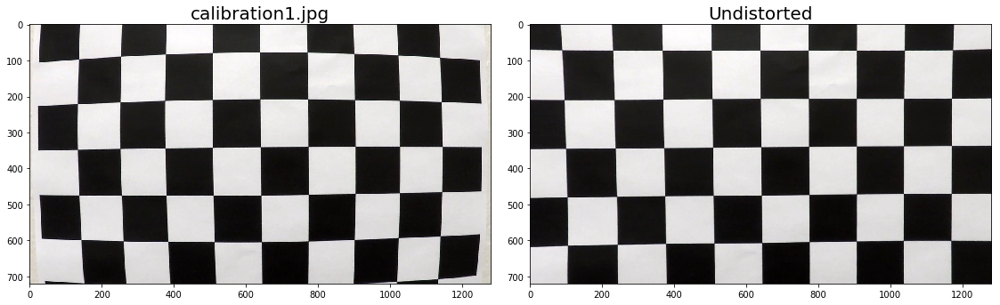

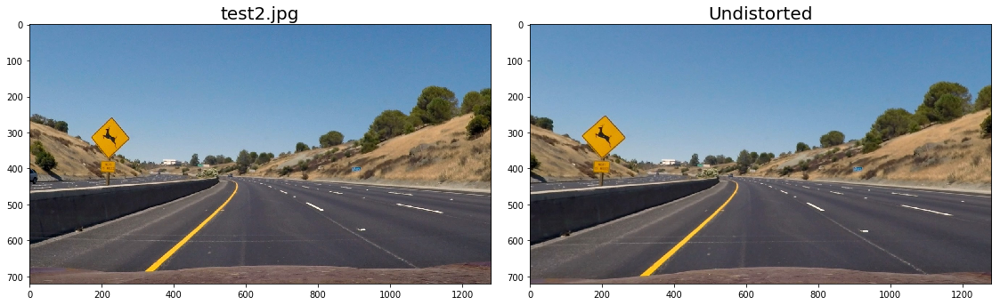

In [3]:
def undistort(img, camera_matrix, distortion_coefficients): 
    '''
    Undistorts the passed in image using the camera matrix & the distortion co-efficients
    '''
    undist = cv2.undistort(img, camera_matrix, distortion_coefficients, None, camera_matrix)
    return undist

# Example run on one of the calibration images
img = cv2.imread('./camera_cal/calibration1.jpg')
undistorted = undistort(img, camera_matrix, distortion_coefficients)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
ax1.set_title('calibration1.jpg', fontsize=20)
ax2.imshow(cv2.cvtColor(undistorted,cv2.COLOR_BGR2RGB))
ax2.set_title('Undistorted', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Example run on a test image
img = cv2.imread('./test_images/test2.jpg')
undistorted = undistort(img, camera_matrix, distortion_coefficients)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
ax1.set_title('test2.jpg', fontsize=20)
ax2.imshow(cv2.cvtColor(undistorted,cv2.COLOR_BGR2RGB))
ax2.set_title('Undistorted', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
### Step 3: Image Thresholding

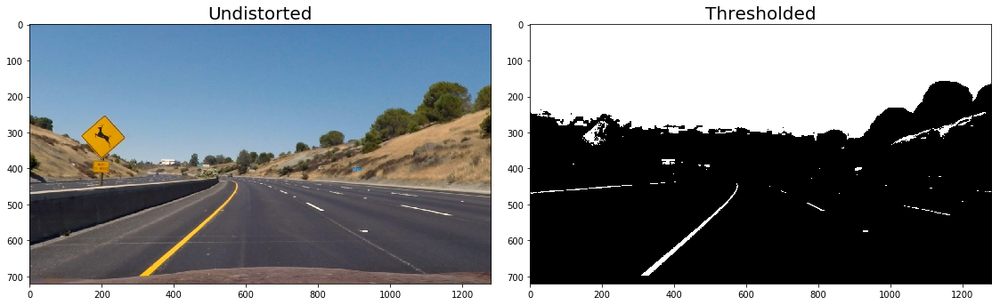

In [4]:
# Various functions for performing thresholding

def abs_sobel_thresh(gray_img, orient='x', sobel_kernel=3, thresh=(25, 255)):
    # Apply x or y gradient with the OpenCV Sobel() function and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    return grad_binary

def magnitude_threshold(gray_img, sobel_kernel=3, mag_thresh=(25, 255)):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1
    # Return the binary image
    return binary_output

def direction_threshold(gray_img, sobel_kernel=3, thresh=(0.5, np.pi/2)):
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return dir_binary

def color_threshold_hls(img, h_thresh=(15, 35), l_thresh=(100, 255), s_thresh=(75, 255)):
    '''
    HLS thresholding
    '''
    # Convert to HLS color space and separate the channels
    hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    h_channel = hls[:,:,0]
    l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
        
    # Threshold H color channel
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    
    # Threshold L color channel
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    # Threshold S color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1   
    
    # Combine the L & S binary thresholds
    combined_binary = np.zeros_like(l_binary)
    #combined_binary[(h_binary == 1) | (l_binary == 1) | (s_binary == 1) ] = 1
    combined_binary[(l_binary == 1) | (s_binary == 1) ] = 1
    return combined_binary

def color_threshold_rgb(img, r_thresh=(15, 35), g_thresh=(100, 255), b_thresh=(75, 255)):
    '''
    RGB thresholding
    '''
    #b_channel = img[:,:,0]
    g_channel = img[:,:,1]
    r_channel = img[:,:,2]
        
    # Threshold B color channel
    #b_binary = np.zeros_like(b_channel)
    #b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    
    # Threshold G color channel
    g_binary = np.zeros_like(g_channel)
    g_binary[(g_channel >= g_thresh[0]) & (g_channel <=g_thresh[1])] = 1
    
    # Threshold R color channel
    r_binary = np.zeros_like(r_channel)
    r_binary[(r_channel >= r_thresh[0]) & (r_channel <= r_thresh[1])] = 1   
    
    # Combine the B,G,R binary thresholds
    combined_binary = np.zeros_like(r_binary)
    #combined_binary[(b_binary == 1) | (g_binary == 1) | (r_binary == 1) ] = 1
    combined_binary[(r_binary == 1) & (g_binary == 1) ] = 1
    return combined_binary

def color_threshold_lab(img, b_thresh=(150,205)):
    '''
    Lab thresholding
    '''
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    b_channel = lab[:,:,2]
    b_binary = np.zeros_like(b_channel)
    b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    return b_binary

def combine_grad_mag_dir_color_threshold(img, ksize = 9):
    '''
    Combines various thresholding functions
    '''
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply each of the thresholding functions

    gradx = abs_sobel_thresh(gray, orient='x', sobel_kernel=ksize, thresh=(35, 100))
    #grady = abs_sobel_thresh(gray, orient='y', sobel_kernel=ksize, thresh=(35, 100))
    #mag_binary = magnitude_threshold(gray, sobel_kernel=ksize, mag_thresh=(25, 100))
    #dir_binary = direction_threshold(gray, sobel_kernel=ksize, thresh=(0.7, 1.3))
    lab_binary = color_threshold_lab(img, b_thresh=(150, 205))
    hls_binary = color_threshold_hls(img, h_thresh=(20, 22), l_thresh=(205, 255), s_thresh=(200, 255))
    rgb_binary = color_threshold_rgb(img, r_thresh=(205, 255), g_thresh=(160, 255), b_thresh=(1, 255))

    combined = np.zeros_like(hls_binary)
    # Here is a selection for pixels where:
    #  Both the x and y gradients
    #  OR the HLS threshold 
    #  OR the Lab threshold
    #  OR the RGB threshold
    #  OR the gradient magnitude and direction 
    # meet the threshold criteria
    
    # However, after several tests it seems that Lab & RGB work best (HLS seems to be picking up unwanted pixels as well)
    combined[
             #((gradx == 1) & (grady == 1)) | 
             #(gradx == 1) |
             #(hls_binary == 1)
             #| 
             (lab_binary == 1)
             | (rgb_binary == 1)
             #| ((mag_binary == 1) & (dir_binary == 1))
            ] = 1
    
    return combined

thresholded = combine_grad_mag_dir_color_threshold(undistorted, ksize = 11)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(cv2.cvtColor(undistorted,cv2.COLOR_BGR2RGB))
ax1.set_title('Undistorted', fontsize=20)
ax2.imshow(thresholded,cmap='gray')
ax2.set_title('Thresholded', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
### Step 4: Image Warping

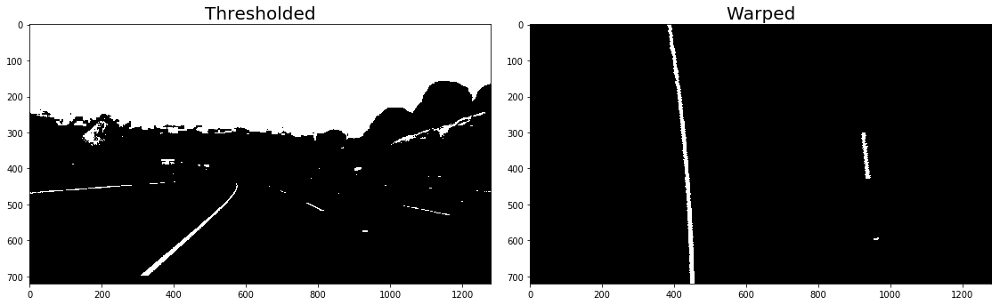

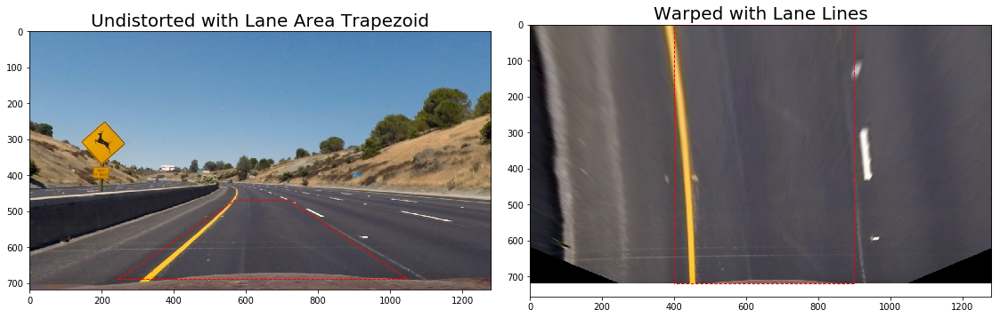

In [5]:
def warp(img):
    '''
    Warps (bird's eye view) an image based on the source & destination points
    '''
    img_size = (img.shape[1],img.shape[0])
    src_points = np.float32([src_left_top, src_right_top, src_right_bottom, src_left_bottom])
    dst_points = np.float32([dst_left_top, dst_right_top, dst_right_bottom, dst_left_bottom])
    
    # Get transform matrix
    M = cv2.getPerspectiveTransform(src_points, dst_points)  
    
    # Get inverse transform matrix
    M_inverse = cv2.getPerspectiveTransform(dst_points, src_points) 
    
    # Warp image
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M_inverse

# Warping example on thresholded image
warped_thresh_img, inverse_transform_matrix = warp(thresholded)
warped_thresh_img = np.uint8(warped_thresh_img)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(thresholded,cmap='gray')
ax1.set_title('Thresholded', fontsize=20)
ax2.imshow(warped_thresh_img,cmap='gray')
ax2.set_title('Warped', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Warping example on original image with lane area drawn (red lines)
warped_undist_img,_ = warp(undistorted)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(cv2.cvtColor(undistorted,cv2.COLOR_BGR2RGB))
ax1.set_title('Undistorted with Lane Area Trapezoid', fontsize=20)
x = [src_left_bottom[0], src_right_bottom[0], src_right_top[0], src_left_top[0], src_left_bottom[0]]
y = [src_left_bottom[1], src_right_bottom[1], src_right_top[1], src_left_top[1], src_left_bottom[1]]
ax1.plot(x, y, 'r--', lw=1)
ax2.imshow(cv2.cvtColor(warped_undist_img,cv2.COLOR_BGR2RGB))
ax2.set_title('Warped with Lane Lines', fontsize=20)
x = [dst_left_top[0], dst_right_top[0], dst_right_bottom[0], dst_left_bottom[0], dst_left_top[0]]
y = [dst_left_top[1], dst_right_top[1], dst_right_bottom[1], dst_left_bottom[1], dst_left_top[1]]
ax2.plot(x, y, 'r--', lw=1)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
### Step 5: Image Histogram

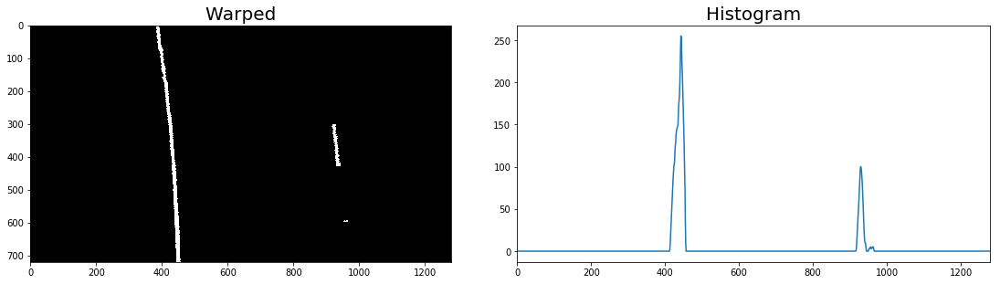

In [6]:
def get_histogram(img, height_factor=2):
    '''
    Constructs a histogram of the passed in image based on the height_factor,
    a height_factor of 2 means that, height-wise, pixels from half to the bottom would be used for constructing the histogram
    '''
    histogram = np.sum(img[int(img.shape[0]/height_factor):,:], axis=0)
    return histogram

hist = get_histogram(warped_thresh_img, height_factor=3.0)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 4))
fig.tight_layout()
ax1.imshow(warped_thresh_img,cmap='gray')
ax1.set_title('Warped', fontsize=20)
ax2.plot(hist)
ax2.set_xlim(0, 1280)
ax2.set_title('Histogram', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
### Step 6: Finding Lane Lines (Window Search & Targeted Search)

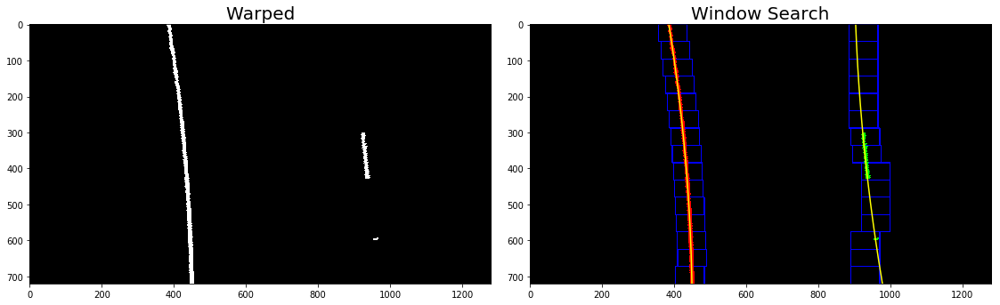

In [7]:
def find_lane_lines_with_window_search(binary_warped, margin=35, minpix=25, nwindows=9, draw_visualization = False):
    '''
    Finds left/right lane lines using window-based strategy.
    First a histogram is built and then the peaks in the histogram are used as the base for starting the line search.
    The image is divided into n number of windows (nwindows) vertically. The horizontal size is based on the +/- margin.
    For each window, (minpix) pixels are identified starting from the bottom & then moving up. 
    Each time as the search goes upwards, the window is recentered based on the mean position of the found pixels.
    In the end, lines are fit based on the identified line pixels.
    '''
    lines_found = False
    out_img = None
    left_fit = None
    right_fit = None
    left_fitted_points_x = None
    right_fitted_points_x = None
    lr_fitted_points_y = None
    
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the 3/4 half of the image
    histogram = get_histogram(warped_thresh_img, height_factor=3.0)
    # Create an output (RGB) image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting points for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    if (nonzero is not None or len(nonzero) > 0):
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set the width of the windows +/- margin
        #margin = 100
        # Set minimum number of pixels found to recenter window
        #minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin

            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high), (0,0,255), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high), (0,0,255), 2) 

            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        if (len(left_lane_inds) > 0 and len(right_lane_inds) > 0):
            # Concatenate the arrays of indices
            left_lane_inds = np.concatenate(left_lane_inds)
            right_lane_inds = np.concatenate(right_lane_inds)

            # Extract left and right line pixel positions
            leftx = nonzerox[left_lane_inds]
            lefty = nonzeroy[left_lane_inds] 
            rightx = nonzerox[right_lane_inds]
            righty = nonzeroy[right_lane_inds] 
            
            if (len(lefty) > 0 and len(leftx) > 0 and len(righty) > 0 and len(rightx) > 0):
                # Fit a second order polynomial to each
                # returns the a,b,c for the equation => y = ax^2 + bx + c (second order polynomial fitting)
                # Note: We are feeding y first, not x. Because we know the positions of y (the fitted line needs to run from top to bottom),
                # but not x
                left_fit = np.polyfit(lefty, leftx, 2)
                right_fit = np.polyfit(righty, rightx, 2)

                # Generate 720 points 
                lr_fitted_points_y = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
                # Generate x and y values for plotting
                #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
                #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
                
                # Instead of setting up the y = ax^2 + bx + c equation manually (as above), 
                # just use the np.poly1d to auto perform the above calculation (returns a function)
                f_left_fitx = np.poly1d(left_fit)
                f_right_fitx = np.poly1d(right_fit)
                left_fitted_points_x = f_left_fitx(lr_fitted_points_y)
                right_fitted_points_x = f_right_fitx(lr_fitted_points_y)

                if (draw_visualization):
                    ## Visualization
                    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0] # red
                    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 255, 0] # green
                    
                lines_found = True
    return lines_found, out_img, left_fit, right_fit, left_fitted_points_x, right_fitted_points_x, lr_fitted_points_y

_, out_img_window, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_with_window_search(
                                                                                                    warped_thresh_img,
                                                                                                    margin=40,
                                                                                                    minpix=15, 
                                                                                                    nwindows=15,
                                                                                                    draw_visualization=True)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(warped_thresh_img,cmap='gray')
ax1.set_title('Warped', fontsize=20)
ax2.imshow(out_img_window,cmap='gray')
ax2.plot(l_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=1.5)
ax2.plot(r_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=1.5)
ax2.set_title('Window Search', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

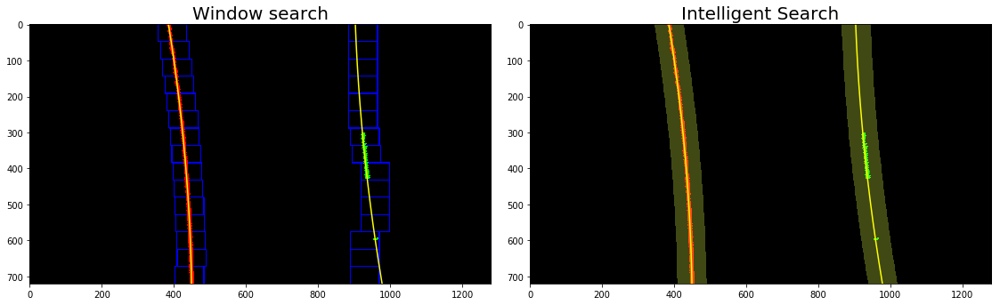

In [8]:
def find_lane_lines(binary_warped, left_fit, right_fit, margin=100, draw_visualization = False):
    '''
    Same as find_lane_lines_with_window_search(), however, rather than performing a blind search, 
    the last fitted lines are used as guide to find the line pixels within the margin.
    '''
    lines_found = False
    result = None
    left_fitted_points_x = None 
    right_fitted_points_x = None
    lr_fitted_points_y = None
    
    # Assume you now have a new warped binary image from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    if (nonzero is not None or len(nonzero) > 0):
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])

        left_lane_inds = (
                            (nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) &
                            (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))
                         ) 

        right_lane_inds = (
                            (nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & 
                            (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin))
                          )  

        if (len(left_lane_inds) > 0 and len(right_lane_inds) > 0):
            # Again, extract left and right line pixel positions
            leftx = nonzerox[left_lane_inds]
            lefty = nonzeroy[left_lane_inds] 
            rightx = nonzerox[right_lane_inds]
            righty = nonzeroy[right_lane_inds]

            if (len(lefty) > 0 and len(leftx) > 0 and len(righty) > 0 and len(rightx) > 0):
                # Fit a second order polynomial to left, right points
                # returns the a,b,c for the equation => y = ax^2 + bx + c (second order polynomial fitting)
                # Note: We are feeding y first, not x. Because we know the positions of y (the fitted line needs to run from top to bottom),
                # but not x
                left_fit = np.polyfit(lefty, leftx, 2)
                right_fit = np.polyfit(righty, rightx, 2)

                # Generate 720 points 
                lr_fitted_points_y = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0])
                # Generate x and y values for plotting
                #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
                #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

                # Instead of setting up the y = ax^2 + bx + c equation manually (as above), 
                # just use the np.poly1d to auto perform the above calculation (returns a function)
                f_left_fitx = np.poly1d(left_fit)
                f_right_fitx = np.poly1d(right_fit)
                left_fitted_points_x = f_left_fitx(lr_fitted_points_y)
                right_fitted_points_x = f_right_fitx(lr_fitted_points_y)

                if (draw_visualization):
                    ## Visualization
                    # Create an image to draw on and an image to show the selection window
                    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
                    window_img = np.zeros_like(out_img)
                    # Color in left and right line pixels
                    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0] # red
                    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 255, 0] # green

                    # Generate a polygon to illustrate the search window area
                    # And recast the x and y points into usable format for cv2.fillPoly()
                    left_line_window1 = np.array([np.transpose(np.vstack([left_fitted_points_x-margin, lr_fitted_points_y]))])
                    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitted_points_x+margin, lr_fitted_points_y])))])
                    left_line_pts = np.hstack((left_line_window1, left_line_window2))
                    right_line_window1 = np.array([np.transpose(np.vstack([right_fitted_points_x-margin, lr_fitted_points_y]))])
                    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitted_points_x+margin, lr_fitted_points_y])))])
                    right_line_pts = np.hstack((right_line_window1, right_line_window2))

                    # Draw the lane onto the warped blank image
                    cv2.fillPoly(window_img, np.int_([left_line_pts]), (212, 244, 66))
                    cv2.fillPoly(window_img, np.int_([right_line_pts]), (212, 244, 66))
                    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)

                lines_found = True
    return lines_found, result, left_fit, right_fit, left_fitted_points_x, right_fitted_points_x, lr_fitted_points_y

_, out_img_intel, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines(
                                                                                                warped_thresh_img,
                                                                                                l_fit, 
                                                                                                r_fit, 
                                                                                                margin=40,
                                                                                                draw_visualization=True)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 10))
fig.tight_layout()
ax1.imshow(out_img_window,cmap='gray')
ax1.plot(l_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=1.5)
ax1.plot(r_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=1.5)
ax1.set_title('Window search', fontsize=20)
ax2.imshow(out_img_intel,cmap='gray')
ax2.plot(l_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=1.5)
ax2.plot(r_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=1.5)
ax2.set_title('Intelligent Search', fontsize=20)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

---
### Step 7: Finding Line Curvature, Lane Center Offset & Lane Width

In [9]:
def find_lr_lines_curvature(img_height, left_fit, right_fit, left_fitted_points_x, right_fitted_points_x):
    '''
    Finds the radius of curvature for left/right lines
    '''
    # Generate 720 points 
    ploty = np.linspace(0, img_height-1, img_height)
    y_eval = np.max(ploty)
    # Define conversions in x and y from pixels space to meters
    #ym_per_pix = 30/720 # meters per pixel in y dimension
    ym_per_pix = 34.3/720 # meters per pixel in y dimension
    #xm_per_pix = 3.7/700 # meters per pixel in x dimension
    xm_per_pix = 3.7/520 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitted_points_x*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitted_points_x*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curve_rad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curve_rad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    return left_curve_rad, right_curve_rad

def find_lane_center_offset(img_width, left_fit, right_fit):
    '''
    Finds how far the center of the vehicle is from the center of the lane.
    Returns both the offset distance and the direction.
    '''
    #xm_per_pix = 3.7/700 # meters per pixel in x dimension
    xm_per_pix = 3.7/520 # meters per pixel in x dimension
    f_left_fitx = np.poly1d(left_fit)
    f_right_fitx = np.poly1d(right_fit)
    lane_left_x = f_left_fitx(719)
    lane_right_x = f_right_fitx(719)
    lane_center = (lane_left_x + lane_right_x) / 2
    car_center = img_width / 2
    lane_center_offset = car_center - lane_center
    offset_dir = 'left' if (lane_center_offset < 0) else 'right'
    lane_center_offset_meters = xm_per_pix * lane_center_offset
    return lane_center_offset_meters, offset_dir

def find_lane_width(left_fit, right_fit):
    '''
    Finds the lane width at the top & bottom of the image.
    '''
    #xm_per_pix = 3.7/700 # meters per pixel in x dimension
    xm_per_pix = 3.7/520 # meters per pixel in x dimension
    f_left_fitx = np.poly1d(left_fit)
    f_right_fitx = np.poly1d(right_fit)
    lane_left_top_x = f_left_fitx(0)
    lane_right_top_x = f_right_fitx(0)
    lane_left_bottom_x = f_left_fitx(719)
    lane_right_bottom_x = f_right_fitx(719)
    lane_width_top = lane_right_top_x - lane_left_top_x
    lane_width_top_meters = xm_per_pix * lane_width_top
    lane_width_bottom = lane_right_bottom_x - lane_left_bottom_x
    lane_width_bottom_meters = xm_per_pix * lane_width_bottom
    return lane_width_top_meters, lane_width_bottom_meters

In [10]:
lr_curv = find_lr_lines_curvature(warped_thresh_img.shape[0], l_fit, r_fit, l_fitted_points_x, r_fitted_points_x)
print('Left lane radius of curvature: {:0.2f} meters, Right lane radius of curvature: {:0.2f} meters'.format(lr_curv[0], lr_curv[1]))

lane_offset_dir  = find_lane_center_offset(warped_thresh_img.shape[1], l_fit, r_fit)  
print('Vehicle offset from lane center: {:0.2f} meters {}'.format(np.absolute(lane_offset_dir[0]), lane_offset_dir[1]))

lane_width_top, lane_width_bottom  = find_lane_width(l_fit, r_fit)
print('Lane width top: {:0.2f} meters, lane width bottom: {:0.2f} meters'.format(lane_width_top, lane_width_bottom))

Left lane radius of curvature: 1597.61 meters, Right lane radius of curvature: 1772.44 meters
Vehicle offset from lane center: 0.52 meters left
Lane width top: 3.69 meters, lane width bottom: 3.76 meters


---
### Step 8: Drawing Lane Area with Lane & Line Information

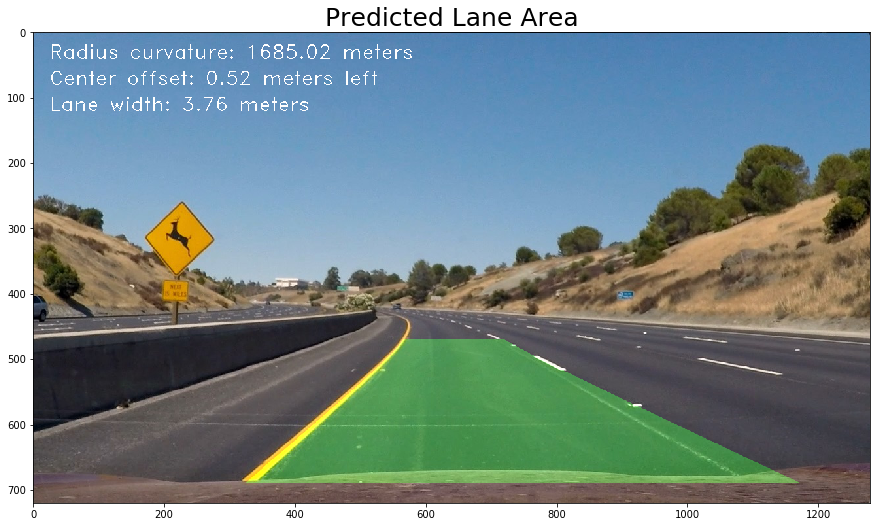

In [11]:
def draw_lane_area_with_info(original_img, warped_thresholded_img, inverse_transform_matrix, left_fitted_points_x, right_fitted_points_x, lr_curv, lane_offset_dir, lane_width):
    '''
    Draws the found out lane area as a light green trapezoid and 
    writes lane curvature (mean of left/right lines' curvature), center offset & lane width information on the original image.
    '''
    img_height = original_img.shape[0]
    ploty = np.linspace(0, img_height-1, img_height)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped_thresholded_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitted_points_x, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitted_points_x, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, inverse_transform_matrix, (original_img.shape[1], original_img.shape[0])) 
    # Combine the result with the original image
    result_BGR = cv2.addWeighted(original_img, 1, newwarp, 0.3, 0)
   
    # Mean curvature
    mean_curvature  = (lr_curv[0] + lr_curv[1])/2
    curvature_text = 'Radius curvature: {:0.2f} meters'.format(mean_curvature)

    # Lane offset
    offset_text = 'Center offset: {:0.2f} meters {}'.format(np.absolute(lane_offset_dir[0]), lane_offset_dir[1])
    
    # lane width at the bottom of the image
    lane_width_text = 'Lane width: {:0.2f} meters'.format(lane_width)
    
    # Add text
    font = cv2.FONT_HERSHEY_DUPLEX
    cv2.putText(result_BGR, curvature_text , (25, 40), font, 1.0, (255,255,255), thickness=1)
    cv2.putText(result_BGR, offset_text, (25, 80), font, 1.0, (255,255,255), thickness=1)
    cv2.putText(result_BGR, lane_width_text, (25, 120), font, 1.0, (255,255,255), thickness=1)
    result_RGB = cv2.cvtColor(result_BGR,cv2.COLOR_BGR2RGB)
    return result_RGB

out_img = draw_lane_area_with_info(img, warped_thresh_img, inverse_transform_matrix, l_fitted_points_x, r_fitted_points_x,
                                   lr_curv, lane_offset_dir, lane_width_bottom)

plt.figure(figsize=(15, 10))
plt.imshow(out_img)
plt.title('Predicted Lane Area',fontsize=25)
plt.show()

---
### Sanity Checks (Lines & Lanes)

In [12]:
# Various sanity checking functions to validate if the found lines are true lines

def are_lines_parallel(width_top, width_bottom):
    parallel = False
    threshold = 0.75
    # lines are parallel if diff is less than/equal to 0.75 meter
    if (np.absolute(width_top -  width_bottom) <= threshold):
        log_file.write('are_lines_parallel() returning True as top & bottom width difference not greater than {} meters\n'.format(threshold))
        parallel = True
    else:
        log_file.write('are_lines_parallel() returning False as top & bottom width difference greater than {} meters\n'.format(threshold))
    return parallel

def is_lane_width_ok(width_top, width_bottom):
    ok = False
    min_width = 3.2
    max_width = 4.2
    # width ok if average width between 3.2 & 4.2 meters
    if (np.mean([width_top, width_bottom]) >= min_width and np.mean([width_top, width_bottom]) <= max_width):
        log_file.write('is_lane_width_ok() returning True as average width between {} and {} meters\n'.format(min_width, max_width))
        ok = True
    else:
        log_file.write('is_lane_width_ok() returning False as average width NOT between {} and {} meters\n'.format(min_width, max_width))
    return ok

def check_if_lines_are_good(img_shape, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x):
    '''
    Combines the above two checks.
    '''
    lane_width_ok, lines_parallel_ok = False, False
    lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = None, None, None, None
    if (type(l_fit) is np.ndarray and type(r_fit) is np.ndarray and type(l_fitted_points_x) is np.ndarray and type(r_fitted_points_x) is np.ndarray):
        if ((l_fitted_points_x is not None) and (len(l_fitted_points_x)) and (r_fitted_points_x is not None) and (len(r_fitted_points_x))):
            lr_curv = find_lr_lines_curvature(img_shape[0], l_fit, r_fit, l_fitted_points_x, r_fitted_points_x)
            lane_offset_dir  = find_lane_center_offset(img_shape[1], l_fit, r_fit)  
            lane_width_top, lane_width_bottom = find_lane_width(l_fit, r_fit)
            log_file.write('Lane width top:{:0.2f} meters, Lane width bottom:{:0.2f} meters\n'.format(lane_width_top, lane_width_bottom))
            log_file.write('Left curvature:{:0.2f} meters, Right curvature:{:0.2f} meters\n'.format(lr_curv[0], lr_curv[1]))
            
            # NOT performing radius of curvature check as it's not meaningful!!!
            #rad_of_curv_ok = l_line.is_curvature_ok(lr_curv[0]) and r_line.is_curvature_ok(lr_curv[1])
            lane_width_ok = is_lane_width_ok(lane_width_top, lane_width_bottom)
            lines_parallel_ok = are_lines_parallel(lane_width_top, lane_width_bottom)
    
    return lane_width_ok, lines_parallel_ok, lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom

def find_lane_lines_from_previous_best(img_height, left_fit, right_fit):
    '''
    Uses the average of the previous five fitted lines (best fit) for line fitting.
    '''
    l_fitted_points_x = None 
    r_fitted_points_x = None
    lr_fitted_points_y = None
    
    lr_fitted_points_y = np.linspace(0, img_height-1, img_height)
    f_left_fitx = np.poly1d(left_fit)
    f_right_fitx = np.poly1d(right_fit)
    l_fitted_points_x = f_left_fitx(lr_fitted_points_y)
    r_fitted_points_x = f_right_fitx(lr_fitted_points_y)
  
    return left_fit, right_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y

---
### Line & Lane Classes

In [13]:
# Line class for keeping track of current & previous parameters
class Line():
    def __init__(self):
        # left or right
        self.direction = None
        # was the line detected in the last iteration?
        self.detected = False   
        # x values of the last 5 fits of the line
        self.recent_xfitted_arr = deque(np.array([[np.nan],[np.nan],[np.nan],[np.nan],[np.nan]]))  
        # average x values of the fitted line over the last 5 iterations
        self.bestx = None         
        # polynomial coefficients averaged over the last 5 iterations
        self.best_fit = np.array([np.nan,np.nan,np.nan])    
        # polynomial co-efficients for the most recent fit
        self.current_fit = np.array([np.nan,np.nan,np.nan])  
        # polynomial co-efficients for the last 5 fits
        self.recent_fit_arr = deque(np.array([[np.nan,np.nan,np.nan],
                                     [np.nan,np.nan,np.nan],
                                     [np.nan,np.nan,np.nan],
                                     [np.nan,np.nan,np.nan],
                                     [np.nan,np.nan,np.nan]]))  
        # difference in fit co-efficients between last and new fits
        self.fit_diffs = np.array([np.nan,np.nan,np.nan])
        # x values for detected line pixels for the most recent fit
        self.allx = None         
        # y values for detected line pixels for the most recent fit
        self.ally = None
        # radius of curvature of the line in meters 
        self.curvature = None
        # radius of curvature of the line in meters for the last 5 iterations
        self.curvature_arr = deque(np.array([np.nan,np.nan,np.nan,np.nan,np.nan]))
        
    def update(self, detected, current_fit, curvature, allx, ally):
        self.detected = detected
        self.current_fit = [current_fit[0],current_fit[1],current_fit[2]]
        self.allx = allx
        self.ally = ally
        
        self.curvature = curvature
        self.curvature_arr.popleft()
        self.curvature_arr.append(curvature)
        
        self.recent_xfitted_arr.popleft()
        self.recent_xfitted_arr.append(allx) 
        self.bestx = np.nanmean(self.recent_xfitted_arr)
        
        last_fit = self.recent_fit_arr[-1]
        if (not math.isnan(last_fit[0])):
            self.fit_diffs = np.absolute(last_fit - current_fit)
        
        self.recent_fit_arr.popleft()
        self.recent_fit_arr.append([current_fit[0],current_fit[1],current_fit[2]]) 
        self.best_fit = np.nanmean(self.recent_fit_arr, axis=0)

    # NOT used as not meaningful    
    def is_curvature_ok(self, curv):
        cur_limit = 500
        # This method is only valid if the lines were detected in the last frame
        ok = False
        if (self.detected):
            # curvature ok if diff from previous is less than/equal to 100 meters
            last_curv= self.curvature_arr[-1]
            if (math.isnan(last_curv)):
                log_file.write('{}: is_curvature_ok() returning True as previous frame curvature is nan\n'.format(self.direction))
                ok = True
            else:    
                if (np.absolute(last_curv - curv) <= cur_limit):
                    log_file.write('{}: previous curvature {:0.2f} meters\n'.format(self.direction, last_curv))
                    log_file.write('{}: is_curvature_ok() returning True as difference from previous frame curvature is not greater than {} meters\n'.format(self.direction, cur_limit))
                    ok = True
                else:
                    log_file.write('{}: previous curvature {:0.2f} meters\n'.format(self.direction, last_curv))
                    log_file.write('{}: is_curvature_ok() returning False as difference from previous frame curvature is greater than {} meters\n'.format(self.direction, cur_limit))
        else:
            log_file.write('{}: is_curvature_ok() returning True as No lines detected in the last frame\n'.format(self.direction))
            ok = True
        return ok

# Lane class for keeping track of current & previous parameters
class Lane():
    def __init__(self):
        # distance in meters of vehicle center from the lane center for the last 5 iterations
        self.center_offset_arr = deque(np.array([np.nan,np.nan,np.nan,np.nan,np.nan]))      
        # lane width (average of top/bottom widths) for the last 5 iterations
        self.width_arr = deque(np.array([np.nan,np.nan,np.nan,np.nan,np.nan]))
        # average center_offset
        self.center_offset_avg = None
        # top lane width
        self.width_top = None
        # bottom lane width
        self.width_bottom = None
        # current lane width (average of top & bottom for current frame)
        self.width = None
        
    def update(self, center_offset, width_top, width_bottom):
        self.center_offset_arr.popleft()
        self.center_offset_arr.append(center_offset)
        self.center_offset_avg = np.nanmean(self.center_offset_arr)
        
        self.width_top = width_top
        self.width_bottom = width_bottom
        self.width = np.mean([self.width_top, self.width_bottom])
        
        self.width_arr.popleft()
        self.width_arr.append(self.width)
    

---
### Main Pipeline Function

In [14]:
def process_frame(frame):
    '''
    Main pipeline function for processing video frames.
    Writes useful messages to a log file. 
    Also writes frames, for which line detection failed, to a debug directory.
    '''
    global frame_counter
    frame_counter += 1
    frame_name = str(frame_counter) + '.jpg'  
    img = frame.copy()
    out_img = frame.copy()
    log_file.write('Processing frame: {}\n'.format(frame_name))
    #out_img_title = frame_name
    undistorted = undistort(img, camera_matrix, distortion_coefficients)
    thresholded = combine_grad_mag_dir_color_threshold(undistorted, ksize = 11)
    warped_thresh_img, inverse_transform_matrix = warp(thresholded)
    warped_thresh_img = np.uint8(warped_thresh_img)

    # Initialise variables for current iteration
    lines_found, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = False, None, None, None, None, None
    lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = None, None, None, None

    # If lines were detected in the previous frame,
    # then use the previous fitted lines to find new lines within the margin
    if (l_line.detected and r_line.detected):
        log_file.write('Finding lines using fitted lines from previous frame...\n')
        lines_found, out_img, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines(
                                                                                                            warped_thresh_img,
                                                                                                            l_line.current_fit, 
                                                                                                            r_line.current_fit, 
                                                                                                            margin=40,
                                                                                                            draw_visualization=False)
        if (lines_found):
            log_file.write('Lines found using fitted lines from previous frame...\n')
        else:
            log_file.write('Lines NOT found using fitted lines from previous frame...\n')

    # If lines were not detected using the previous frame fit OR this is the first frame,
    # start from scratch by using window based search
    if (not lines_found):
        log_file.write('Performing line search from scratch using window search...\n')
        lines_found, out_img, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_with_window_search(
                                                                                                            warped_thresh_img,
                                                                                                            margin=40,
                                                                                                            minpix=15, 
                                                                                                            nwindows=15,
                                                                                                            draw_visualization=False)
        if (lines_found):
            log_file.write('Lines found after performing window search...\n')
        else:
            log_file.write('Lines NOT found after performing window search...\n')
       
    if (lines_found):
        log_file.write('Now checking if found lines are any good...\n')
        lane_width_ok, lines_parallel_ok, lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = check_if_lines_are_good(warped_thresh_img.shape,
                                                                                                             l_fit, r_fit, 
                                                                                                             l_fitted_points_x, 
                                                                                                             r_fitted_points_x)

        if (lane_width_ok and lines_parallel_ok):
            log_file.write('Lines are good...\n')
            # Update the lines & lane objects with new info
            l_line.update(lines_found, l_fit, lr_curv[0], l_fitted_points_x, lr_fitted_points_y)
            r_line.update(lines_found, r_fit, lr_curv[1], r_fitted_points_x, lr_fitted_points_y)
            lane.update(lane_offset_dir[0], lane_width_top, lane_width_bottom)

            out_img = draw_lane_area_with_info(img, 
                                               warped_thresh_img, 
                                               inverse_transform_matrix, 
                                               l_line.allx, 
                                               r_line.allx,
                                               lr_curv, 
                                               lane_offset_dir,
                                               lane_width_bottom)
            out_img = cv2.cvtColor(out_img,cv2.COLOR_BGR2RGB)
        else:
            log_file.write('Lines NOT good!!! Now performing line search from scratch using window search...\n')
            lines_found, out_img, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_with_window_search(
                                                                                                            warped_thresh_img,
                                                                                                            margin=40,
                                                                                                            minpix=15, 
                                                                                                            nwindows=15,
                                                                                                            draw_visualization=False)        
            if (lines_found):
                log_file.write('Lines found after performing window search...\n')
                log_file.write('Now checking if found lines are any good...\n')
                lane_width_ok, lines_parallel_ok, lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = check_if_lines_are_good(warped_thresh_img.shape,
                                                                                                             l_fit, r_fit, 
                                                                                                             l_fitted_points_x, 
                                                                                                             r_fitted_points_x)


                if (lane_width_ok and lines_parallel_ok):
                    log_file.write('Lines are good...\n')
                    # Update the lines & lane objects with new info
                    l_line.update(lines_found, l_fit, lr_curv[0], l_fitted_points_x, lr_fitted_points_y)
                    r_line.update(lines_found, r_fit, lr_curv[1], r_fitted_points_x, lr_fitted_points_y)
                    lane.update(lane_offset_dir[0], lane_width_top, lane_width_bottom)

                    out_img = draw_lane_area_with_info(img, 
                                                       warped_thresh_img, 
                                                       inverse_transform_matrix, 
                                                       l_line.allx, 
                                                       r_line.allx,
                                                       lr_curv, 
                                                       lane_offset_dir,
                                                       lane_width_bottom)
                    out_img = cv2.cvtColor(out_img,cv2.COLOR_BGR2RGB)
                else:
                    log_file.write('Lines NOT good!!! Will try using best fit...\n')
                    l_line.detected = False
                    r_line.detected = False
                    if (math.isnan(l_line.best_fit[0]) or math.isnan(l_line.best_fit[1]) or math.isnan(l_line.best_fit[2]) or
                       math.isnan(r_line.best_fit[0]) or math.isnan(r_line.best_fit[1]) or math.isnan(r_line.best_fit[2])):
                        log_file.write('Cannot use best fit as polyfit co-efficients are no good!!! skipping frame {}...\n'.format(frame_name))
                        out_img = frame.copy()
                        cv2.imwrite('./video_debug_frames/' + frame_name, cv2.cvtColor(frame.copy(),cv2.COLOR_BGR2RGB))
                    else:
                        l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_from_previous_best(
                                                                                                                    warped_thresh_img.shape[0], 
                                                                                                                    l_line.best_fit, 
                                                                                                                    r_line.best_fit)
                        log_file.write('Lines fitted using best fit. Now checking if found lines are any good...\n')
                        lane_width_ok, lines_parallel_ok, lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = check_if_lines_are_good(
                                                                                                            warped_thresh_img.shape,
                                                                                                            l_fit, r_fit, 
                                                                                                            l_fitted_points_x, 
                                                                                                            r_fitted_points_x)

                        if (lane_width_ok and lines_parallel_ok):
                            log_file.write('Lines are good...\n')

                            out_img = draw_lane_area_with_info(img, 
                                                               warped_thresh_img, 
                                                               inverse_transform_matrix, 
                                                               l_line.allx, 
                                                               r_line.allx,
                                                               lr_curv, 
                                                               lane_offset_dir,
                                                               lane_width_bottom)
                            out_img = cv2.cvtColor(out_img,cv2.COLOR_BGR2RGB)                                                             
                        else:
                            log_file.write('Lines NOT good!!! Skipping frame {}...\n'.format(frame_name))
                            out_img = frame.copy()
                            cv2.imwrite('./video_debug_frames/' + frame_name, cv2.cvtColor(frame.copy(),cv2.COLOR_BGR2RGB))
            else:
                log_file.write('Lines NOT found using window search!!! Will try using best fit...\n')
                l_line.detected = False
                r_line.detected = False
                if (math.isnan(l_line.best_fit[0]) or math.isnan(l_line.best_fit[1]) or math.isnan(l_line.best_fit[2]) or
                   math.isnan(r_line.best_fit[0]) or math.isnan(r_line.best_fit[1]) or math.isnan(r_line.best_fit[2])):
                    log_file.write('Cannot use best fit as polyfit co-efficients are no good!!! skipping frame {}...\n'.format(frame_name))
                    out_img = frame.copy()
                    cv2.imwrite('./video_debug_frames/' + frame_name, cv2.cvtColor(frame.copy(),cv2.COLOR_BGR2RGB))
                else:
                    l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_from_previous_best(
                                                                                                                warped_thresh_img.shape[0], 
                                                                                                                l_line.best_fit, 
                                                                                                                r_line.best_fit)
                    log_file.write('Lines fitted using previous best fit. Now checking if found lines are any good...\n')
                    lane_width_ok, lines_parallel_ok, lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = check_if_lines_are_good(
                                                                                                            warped_thresh_img.shape,
                                                                                                             l_fit, r_fit, 
                                                                                                             l_fitted_points_x, 
                                                                                                             r_fitted_points_x)

                    if (lane_width_ok and lines_parallel_ok):
                        log_file.write('Lines are good...\n')

                        out_img = draw_lane_area_with_info(img, 
                                                           warped_thresh_img, 
                                                           inverse_transform_matrix, 
                                                           l_line.allx, 
                                                           r_line.allx,
                                                           lr_curv, 
                                                           lane_offset_dir,
                                                           lane_width_bottom)
                        out_img = cv2.cvtColor(out_img,cv2.COLOR_BGR2RGB)
                    else:
                        log_file.write('Lines NOT good!!! Skipping frame {}...\n'.format(frame_name))
                        out_img = frame.copy()
                        cv2.imwrite('./video_debug_frames/' + frame_name, cv2.cvtColor(frame.copy(),cv2.COLOR_BGR2RGB))
               
    else:
        log_file.write('Lines NOT found!!! Will try using best fit...\n')
        l_line.detected = False
        r_line.detected = False
        if (math.isnan(l_line.best_fit[0]) or math.isnan(l_line.best_fit[1]) or math.isnan(l_line.best_fit[2]) or
           math.isnan(r_line.best_fit[0]) or math.isnan(r_line.best_fit[1]) or math.isnan(r_line.best_fit[2])):
            log_file.write('Cannot use average fit as polyfit co-efficients are no good!!! skipping frame {}...\n'.format(frame_name))
            out_img = frame.copy()
            cv2.imwrite('./video_debug_frames/' + frame_name, cv2.cvtColor(frame.copy(),cv2.COLOR_BGR2RGB))
        else:
            l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_from_previous_best(
                                                                                                        warped_thresh_img.shape[0], 
                                                                                                        l_line.best_fit, 
                                                                                                        r_line.best_fit)
            log_file.write('Lines fitted using best fit. Now checking if found lines are any good...\n')
            lane_width_ok, lines_parallel_ok, lr_curv, lane_offset_dir, lane_width_top, lane_width_bottom = check_if_lines_are_good(
                                                                                                                warped_thresh_img.shape,
                                                                                                                l_fit, r_fit, 
                                                                                                                l_fitted_points_x, 
                                                                                                                r_fitted_points_x)

            if (lane_width_ok and lines_parallel_ok):
                log_file.write('Lines are good...\n')

                out_img = draw_lane_area_with_info(img, 
                                                   warped_thresh_img, 
                                                   inverse_transform_matrix, 
                                                   l_line.allx, 
                                                   r_line.allx,
                                                   lr_curv, 
                                                   lane_offset_dir,
                                                   lane_width_bottom)
                out_img = cv2.cvtColor(out_img,cv2.COLOR_BGR2RGB)
            else:
                log_file.write('Lines NOT good!!! Skipping frame {}...\n'.format(frame_name))
                out_img = frame.copy()
                cv2.imwrite('./video_debug_frames/' + frame_name, cv2.cvtColor(frame.copy(),cv2.COLOR_BGR2RGB))

    log_file.write('-'*125 + '\n')
    return out_img

---
### Pipeline Run on Test Images

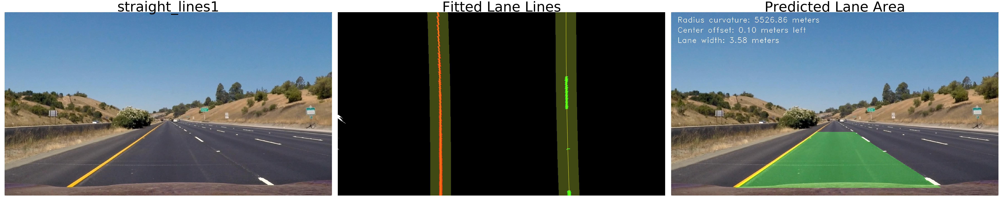

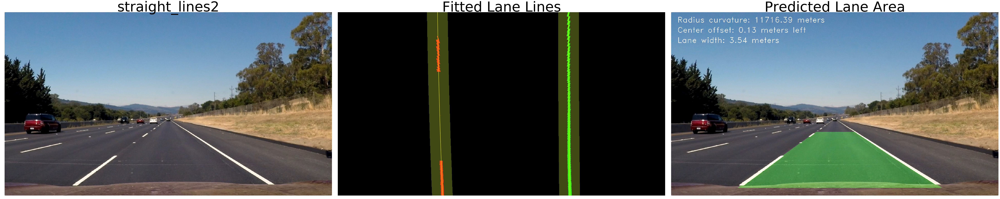

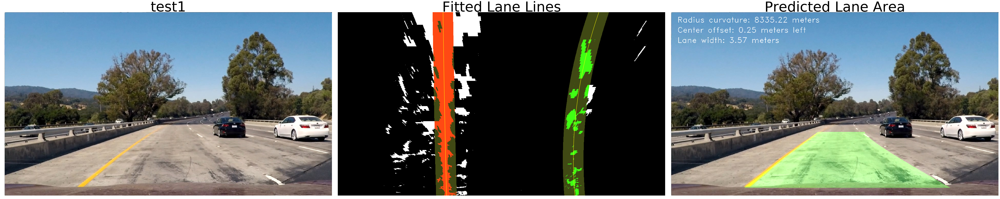

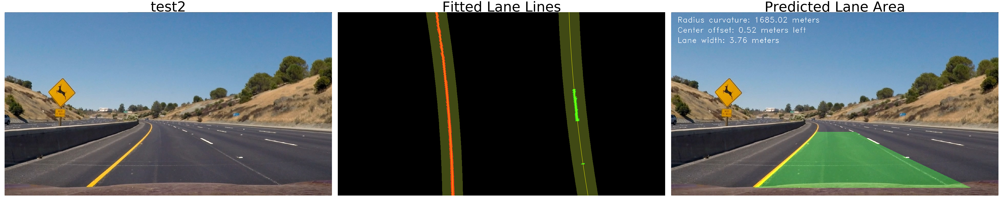

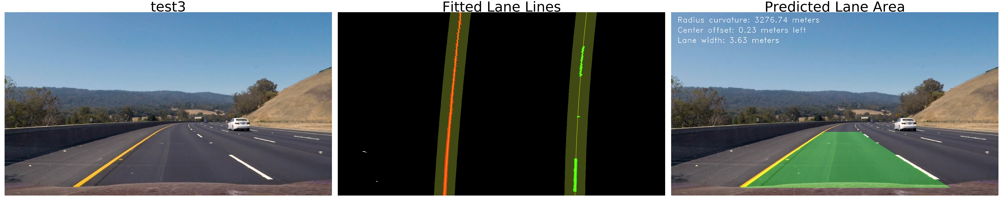

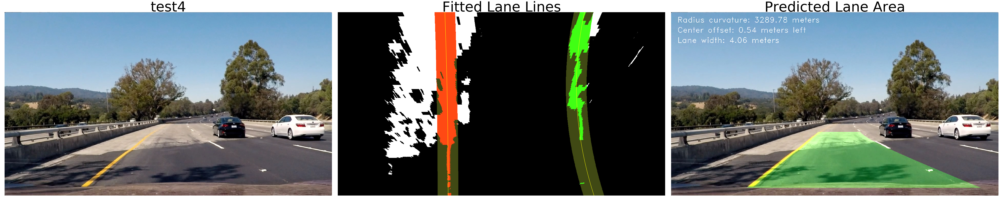

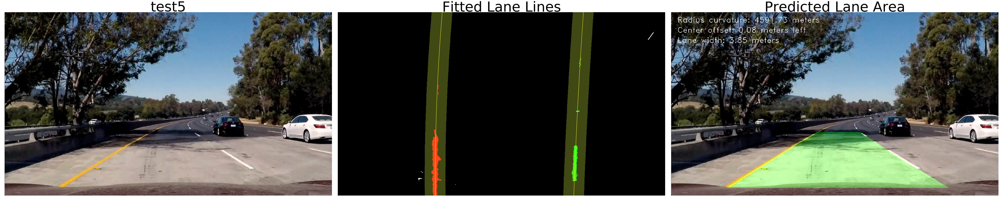

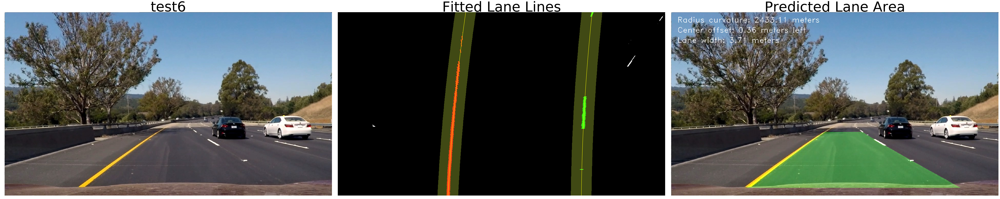

In [15]:
# Pipeline run on test images with output from selected stages

test_images_path = glob.glob('./test_images/*.jpg')
for i in range(0,len(test_images_path)):
    img = cv2.imread(test_images_path[i])

    undistorted = undistort(img, camera_matrix, distortion_coefficients)
    thresholded = combine_grad_mag_dir_color_threshold(undistorted, ksize = 11)
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(100, 50))
    fig.subplots_adjust(hspace = 0.1, wspace = 0.0001)
    fig.tight_layout()
    
    ax1.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
    ax1.set_xlim(0, 1280)
    ax1.set_ylim(720, 0)
    ax1.set_title(test_images_path[i].split('\\')[-1].split('.')[0], fontsize=100)
    ax1.axis('off')

    warped_thresh_img, inverse_transform_matrix = warp(thresholded)
    warped_thresh_img = np.uint8(warped_thresh_img) 
       
    lines_found, out_img, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines_with_window_search(
                                                                                                            warped_thresh_img,
                                                                                                            margin=40,
                                                                                                            minpix=15, 
                                                                                                            nwindows=15,
                                                                                                            draw_visualization=True)   
    
    lines_found, out_img, l_fit, r_fit, l_fitted_points_x, r_fitted_points_x, lr_fitted_points_y = find_lane_lines(
                                                                                                    warped_thresh_img,
                                                                                                    l_fit, 
                                                                                                    r_fit, 
                                                                                                    margin=40,
                                                                                                    draw_visualization=True)
                                             
    ax2.imshow(out_img)
    ax2.plot(l_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=2.0)
    ax2.plot(r_fitted_points_x, lr_fitted_points_y, color='yellow', linewidth=2.0)
    ax2.set_xlim(0, 1280)
    ax2.set_ylim(720, 0)
    ax2.set_title('Fitted Lane Lines', fontsize=100)
    ax2.axis('off')
       
    lr_curv = find_lr_lines_curvature(warped_thresh_img.shape[0], l_fit, r_fit, l_fitted_points_x, r_fitted_points_x)
    lane_offset_dir  = find_lane_center_offset(warped_thresh_img.shape[1], l_fit, r_fit)  
    lane_width_top, lane_width_bottom = find_lane_width(l_fit, r_fit)
    
    out_img = draw_lane_area_with_info(img, 
                                   warped_thresh_img, 
                                   inverse_transform_matrix, 
                                   l_fitted_points_x, 
                                   r_fitted_points_x,
                                   lr_curv, 
                                   lane_offset_dir,
                                   lane_width_bottom)
    ax3.imshow(out_img)
    ax3.set_xlim(0, 1280)
    ax3.set_ylim(720, 0)
    ax3.set_title('Predicted Lane Area', fontsize=100)
    ax3.axis('off')
    
    plt.show()

---
### Video Processing

In [16]:
# Video processing via the pipeline

log_file = open('./log.txt', 'w')                     
l_line = Line()
l_line.direction = 'Left'
r_line = Line()
r_line.direction = 'Right'
lane = Lane()
frame_counter = 0

video_output_raw = './project_video_output.mp4'
clip1_raw = VideoFileClip('./project_video.mp4')
video_clip_raw = clip1_raw.fl_image(process_frame) 
%time video_clip_raw.write_videofile(video_output_raw, audio=False)

log_file.close()

[MoviePy] >>>> Building video ./project_video_output.mp4
[MoviePy] Writing video ./project_video_output.mp4


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [08:13<00:00,  2.52it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ./project_video_output.mp4 

Wall time: 8min 16s


In [17]:
HTML("""
<video width="720" height="560" controls>
  <source src="{0}" type="video/mp4">
</video>
""".format(video_output_raw))